Import libraries

In [1]:
import tempfile
import shutil
import io
import os

import numpy as np
import pandas as pd
import torch
from tqdm import tqdm
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.colors import ListedColormap
from PIL import Image

from monai.utils import set_determinism
from monai.networks.nets import UNet
from monai.networks.layers import Norm
from monai.data import Dataset
from monai.inferers import sliding_window_inference
from monai.transforms import (
    Compose,
    LoadImaged,
    EnsureChannelFirstd,
    Spacingd,
    Orientationd,
    ScaleIntensityRanged,
    CropForegroundd,
    EnsureTyped,
    ToTensord
)

from utils.data_load import get_data_list, get_case_dataset_3d
from utils.transforms import get_3D_transforms
from utils.inference import get_case_predictions_3d, evaluate_predictions
from utils.viz import plot_predictions_3D

Set determinism to `seed=42` and cuda to GPU (fallback CPU)

In [2]:
set_determinism(seed=42)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Device: {device}", flush=True)

Device: cuda


Set paths to dataset and model checkpoint

In [3]:
DATA_ROOT = "/scratch/cv-course2025/lschind5/kits19/data"
NUM_WORKERS = 4
MODEL_PATH = "/home/group.kurse/cviwo008/Project/" # Update this path to your model path
MODEL_NAME = "kits19-model-3d-unet-V5.pth" # Update this to your model name

Verify if it has been loaded

In [4]:
all_cases = get_data_list(DATA_ROOT)
print(f"   Found {len(all_cases)} cases", flush=True)

   Found 210 cases


Load validation set

In [5]:
train_data, val_data = train_test_split(
    all_cases, test_size=0.2, random_state=42
)

val_cases = [case["case_id"] for case in val_data]
test_cases = [f"case_{i:05d}" for i in range(210, 299)]

Define UNet model as in 3D U-Net training

In [6]:
model = UNet(
    spatial_dims=3,
    in_channels=1,
    out_channels=3,
    channels=(30, 60, 120, 240, 320),
    strides=(2, 2, 2, 2),
    num_res_units=3,
    act="PRELU",
    norm=Norm.INSTANCE,
    dropout=0.0,
    kernel_size=3,
    up_kernel_size=3
)

Load checkpoint

In [7]:
checkpoint = torch.load(
    os.path.join(MODEL_PATH, MODEL_NAME), 
    map_location=device
)
model.load_state_dict(checkpoint)

model = model.to(device)

Get validation transforms pipeline

In [8]:
train_transforms, val_transforms = get_3D_transforms()

Get prediction on validation set

In [9]:
val_data = {}
for case in tqdm(val_cases):
    print(case)
            
    case_dataset, case_image, case_label = get_case_dataset_3d(
        case, DATA_ROOT, val_transforms, NUM_WORKERS
    )
    case_predictions = get_case_predictions_3d(model, case_dataset, device)
    
    val_data[case] = {
        "case_id": case,
        "image": case_image,           # Original NIfTI image for metadata
        "ground_truth": case_label,    # Transformed label tensor (same space as predictions)
        "predictions": case_predictions # Predictions tensor (same space as ground_truth)
    }

  0%|                                                                                            | 0/42 [00:00<?, ?it/s]

case_00030


  2%|██                                                                                  | 1/42 [00:02<01:33,  2.28s/it]

case_00172


  5%|████                                                                                | 2/42 [00:05<01:54,  2.87s/it]

case_00084


  7%|██████                                                                              | 3/42 [00:12<03:12,  4.93s/it]

case_00199


 10%|████████                                                                            | 4/42 [00:16<02:44,  4.34s/it]

case_00060


 12%|██████████                                                                          | 5/42 [00:20<02:39,  4.31s/it]

case_00155


 14%|████████████                                                                        | 6/42 [00:30<03:43,  6.21s/it]

case_00045


 17%|██████████████                                                                      | 7/42 [00:32<02:53,  4.94s/it]

case_00182


 19%|████████████████                                                                    | 8/42 [00:37<02:40,  4.73s/it]

case_00009


 21%|██████████████████                                                                  | 9/42 [00:39<02:14,  4.09s/it]

case_00196


 24%|███████████████████▊                                                               | 10/42 [00:45<02:23,  4.48s/it]

case_00136


 26%|█████████████████████▋                                                             | 11/42 [00:48<02:10,  4.21s/it]

case_00187


 29%|███████████████████████▋                                                           | 12/42 [00:51<01:52,  3.75s/it]

case_00207


 31%|█████████████████████████▋                                                         | 13/42 [00:56<02:01,  4.18s/it]

case_00126


 33%|███████████████████████████▋                                                       | 14/42 [01:01<02:00,  4.30s/it]

case_00015


 36%|█████████████████████████████▋                                                     | 15/42 [01:03<01:41,  3.75s/it]

case_00073


 38%|███████████████████████████████▌                                                   | 16/42 [01:09<01:51,  4.30s/it]

case_00165


 40%|█████████████████████████████████▌                                                 | 17/42 [01:23<03:05,  7.40s/it]

case_00018


 43%|███████████████████████████████████▌                                               | 18/42 [01:27<02:31,  6.30s/it]

case_00168


 45%|█████████████████████████████████████▌                                             | 19/42 [01:30<02:00,  5.24s/it]

case_00093


 48%|███████████████████████████████████████▌                                           | 20/42 [01:43<02:50,  7.73s/it]

case_00075


 50%|█████████████████████████████████████████▌                                         | 21/42 [01:47<02:14,  6.42s/it]

case_00055


 52%|███████████████████████████████████████████▍                                       | 22/42 [01:51<01:56,  5.82s/it]

case_00147


 55%|█████████████████████████████████████████████▍                                     | 23/42 [01:55<01:37,  5.16s/it]

case_00109


 57%|███████████████████████████████████████████████▍                                   | 24/42 [01:57<01:17,  4.32s/it]

case_00108


 60%|█████████████████████████████████████████████████▍                                 | 25/42 [02:00<01:05,  3.83s/it]

case_00142


 62%|███████████████████████████████████████████████████▍                               | 26/42 [02:06<01:11,  4.49s/it]

case_00025


 64%|█████████████████████████████████████████████████████▎                             | 27/42 [02:09<01:01,  4.11s/it]

case_00125


 67%|███████████████████████████████████████████████████████▎                           | 28/42 [02:15<01:05,  4.67s/it]

case_00016


 69%|█████████████████████████████████████████████████████████▎                         | 29/42 [02:20<01:01,  4.70s/it]

case_00173


 71%|███████████████████████████████████████████████████████████▎                       | 30/42 [02:24<00:54,  4.51s/it]

case_00192


 74%|█████████████████████████████████████████████████████████████▎                     | 31/42 [02:29<00:50,  4.55s/it]

case_00069


 76%|███████████████████████████████████████████████████████████████▏                   | 32/42 [02:32<00:41,  4.19s/it]

case_00101


 79%|█████████████████████████████████████████████████████████████████▏                 | 33/42 [02:46<01:04,  7.17s/it]

case_00067


 81%|███████████████████████████████████████████████████████████████████▏               | 34/42 [02:52<00:54,  6.87s/it]

case_00104


 83%|█████████████████████████████████████████████████████████████████████▏             | 35/42 [02:57<00:43,  6.21s/it]

case_00132


 86%|███████████████████████████████████████████████████████████████████████▏           | 36/42 [03:07<00:43,  7.27s/it]

case_00180


 88%|█████████████████████████████████████████████████████████████████████████          | 37/42 [03:11<00:31,  6.29s/it]

case_00095


 90%|███████████████████████████████████████████████████████████████████████████        | 38/42 [03:18<00:26,  6.58s/it]

case_00082


 93%|█████████████████████████████████████████████████████████████████████████████      | 39/42 [03:22<00:17,  5.77s/it]

case_00159


 95%|███████████████████████████████████████████████████████████████████████████████    | 40/42 [03:35<00:15,  7.86s/it]

case_00197


 98%|█████████████████████████████████████████████████████████████████████████████████  | 41/42 [03:40<00:07,  7.03s/it]

case_00162


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [03:43<00:00,  5.32s/it]


Calculate different metrics scores

In [10]:
metrics_standard_nofpbg, _ = evaluate_predictions(val_data, exclude_false_positives=True, slice_wise=False, exclude_background_slices=True)
metrics_standard_nobg, _ = evaluate_predictions(val_data, exclude_false_positives=False, slice_wise=False, exclude_background_slices=True)
metrics_standard_nofp, _ = evaluate_predictions(val_data, exclude_false_positives=True, slice_wise=False, exclude_background_slices=False)
metrics_slices, _ = evaluate_predictions(val_data, exclude_false_positives=False, slice_wise=True, exclude_background_slices=False)
metrics_slices_nofpbg, _ = evaluate_predictions(val_data, exclude_false_positives=True, slice_wise=True, exclude_background_slices=True)
metrics_slices_nobg, _ = evaluate_predictions(val_data, exclude_false_positives=False, slice_wise=True, exclude_background_slices=True)
metrics_slices_nofp, _ = evaluate_predictions(val_data, exclude_false_positives=True, slice_wise=True, exclude_background_slices=False)
metrics_standard, val_with_scores = evaluate_predictions(val_data, exclude_false_positives=False, slice_wise=False, exclude_background_slices=False)

Output standard metric

In [11]:
metrics_standard

{'kidney_dice': 0.8870524955647332,
 'tumor_dice': 0.6062623018141104,
 'bg_dice': 0.9990982810656229,
 'evaluation_mode': 'case-wise (3D)'}

Save metrics to csv

In [12]:
# save in .csv
results = [metrics_standard, metrics_standard_nobg, metrics_standard_nofpbg, metrics_slices, metrics_slices_nofp, metrics_slices_nobg, metrics_slices_nofpbg]
df = pd.DataFrame(results)
os.makedirs(os.path.join(MODEL_PATH, "results"), exist_ok=True)
df.to_csv(os.path.join(MODEL_PATH, "results", "eval_results.csv"), index=False)

Plot predictions in 3D visualization space

Plotting case_00197: GT shape (269, 246, 171), Pred shape (269, 246, 171)


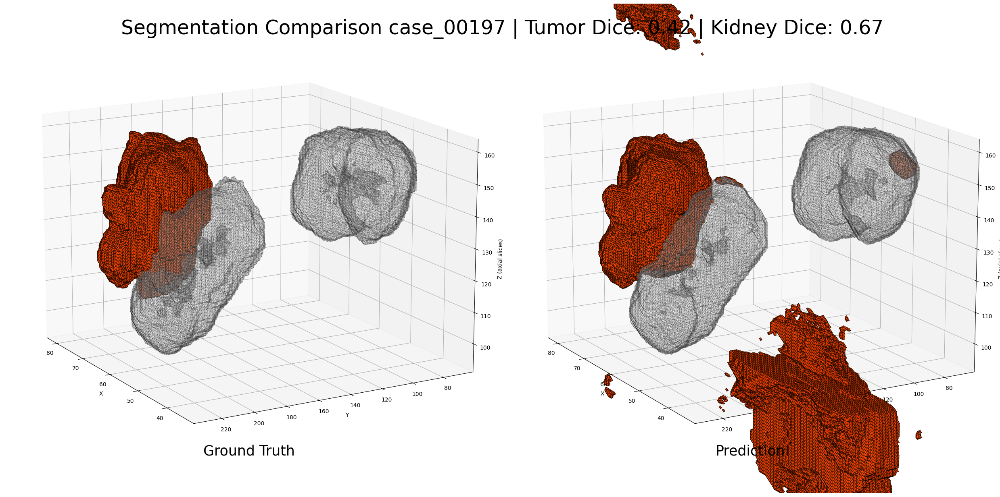

Plotting case_00015: GT shape (243, 205, 160), Pred shape (243, 205, 160)


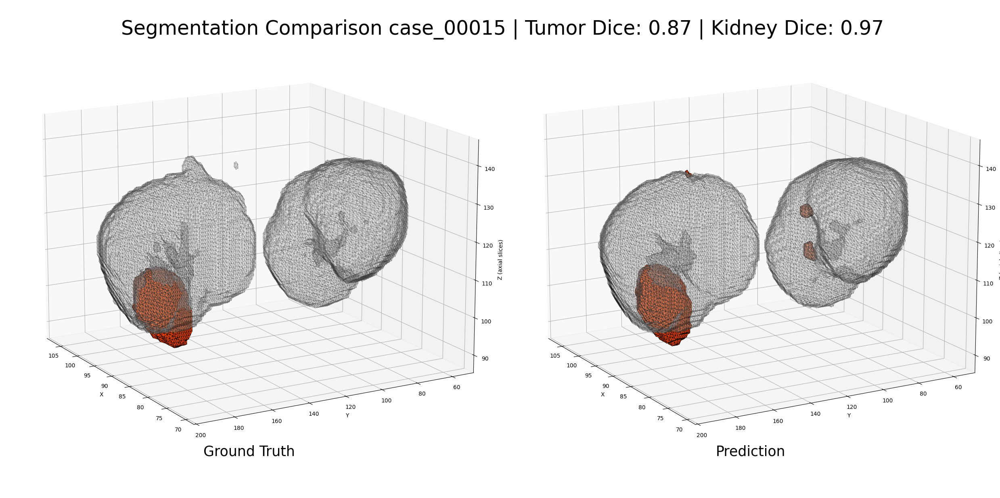

Plotting case_00109: GT shape (204, 160, 160), Pred shape (204, 160, 160)


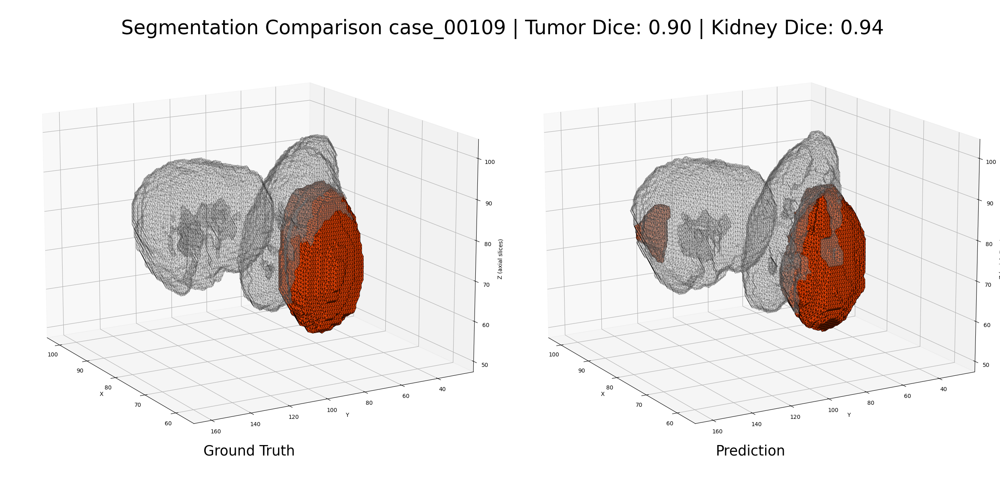

Plotting case_00067: GT shape (258, 201, 160), Pred shape (258, 201, 160)


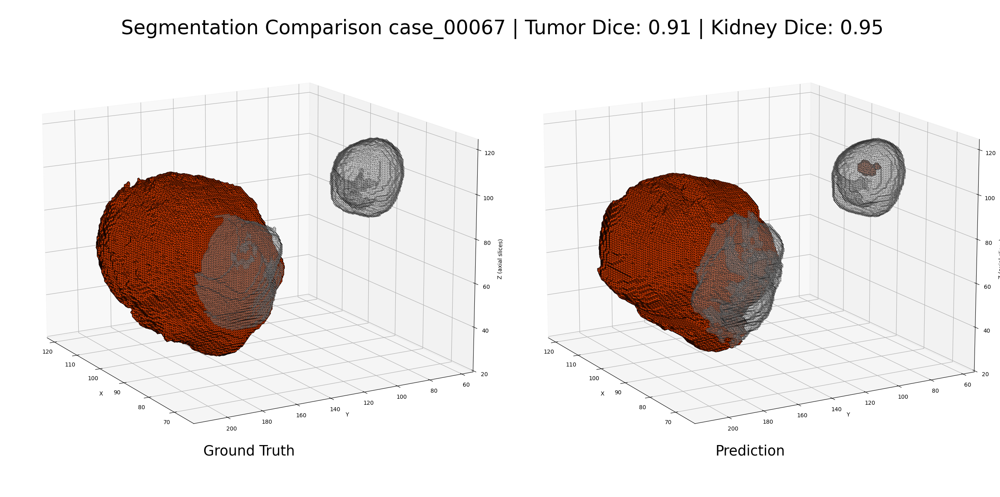

Plotting case_00082: GT shape (267, 199, 160), Pred shape (267, 199, 160)


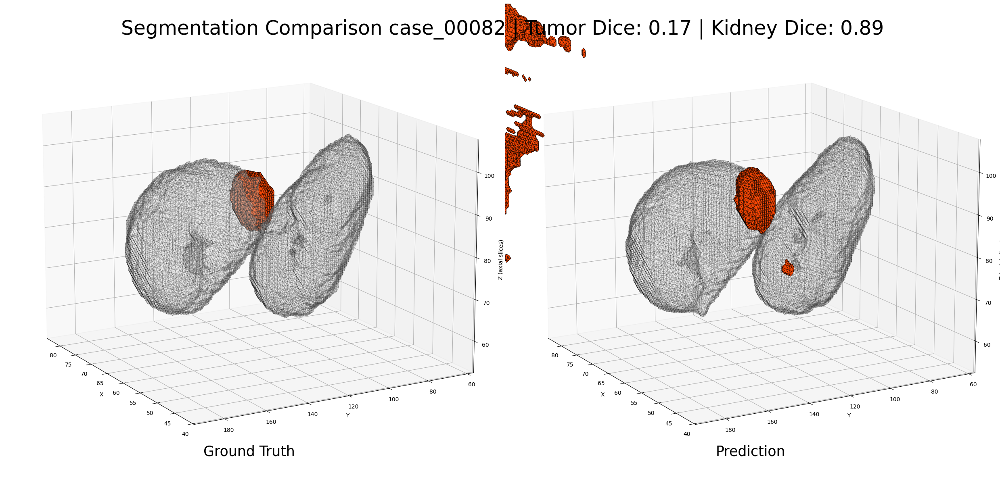

Plotting case_00132: GT shape (246, 187, 160), Pred shape (246, 187, 160)


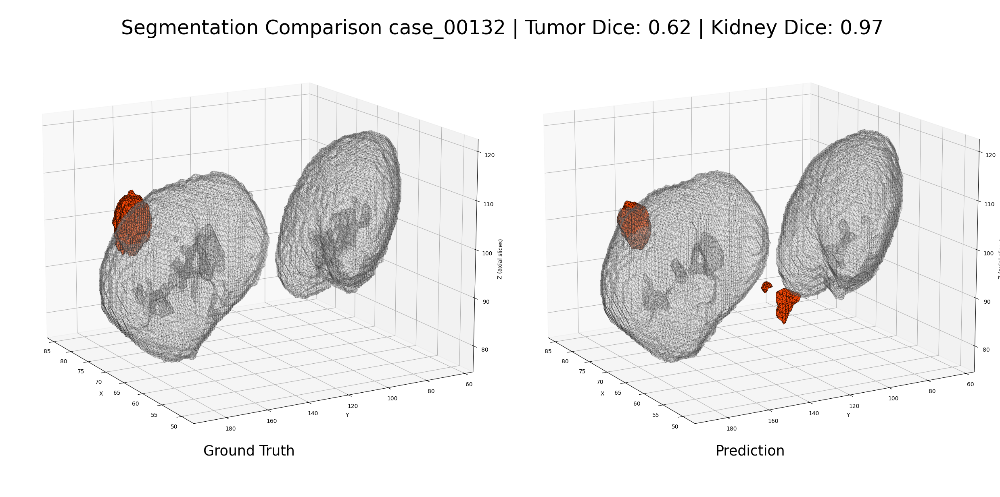

Plotting case_00075: GT shape (244, 198, 160), Pred shape (244, 198, 160)


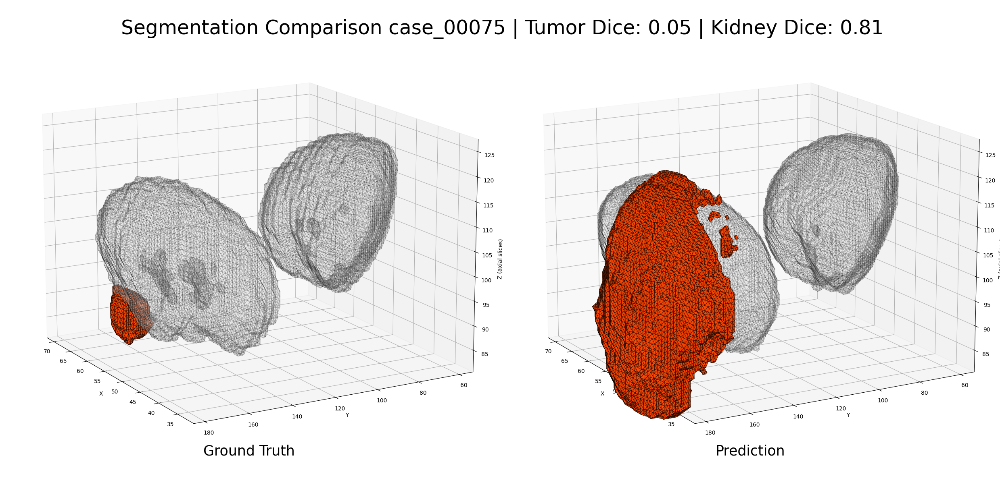

Plotting case_00165: GT shape (319, 269, 249), Pred shape (319, 269, 249)


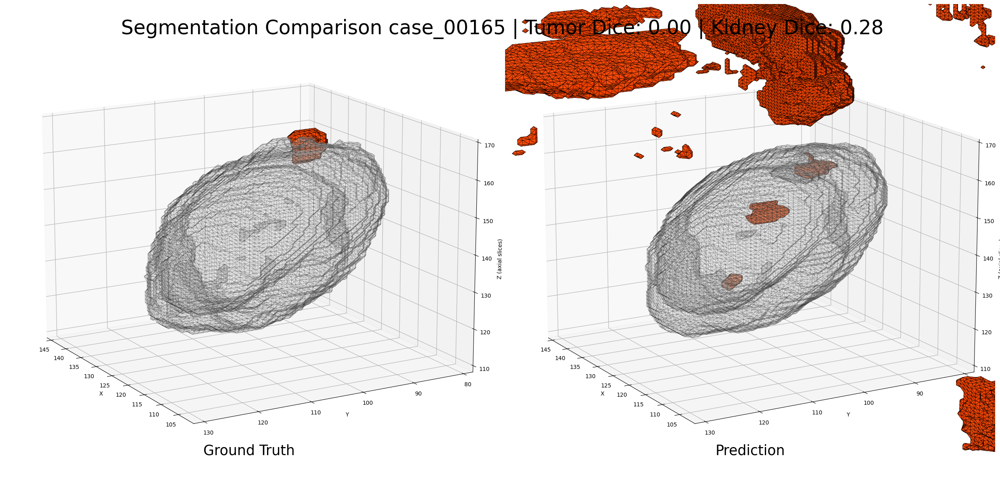

Plotting case_00196: GT shape (233, 179, 186), Pred shape (233, 179, 186)


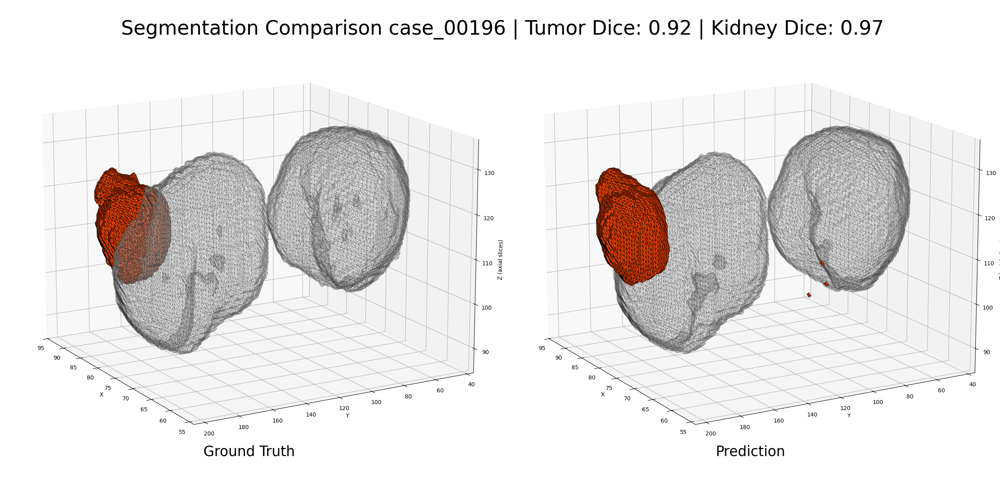

Plotting case_00093: GT shape (308, 273, 160), Pred shape (308, 273, 160)


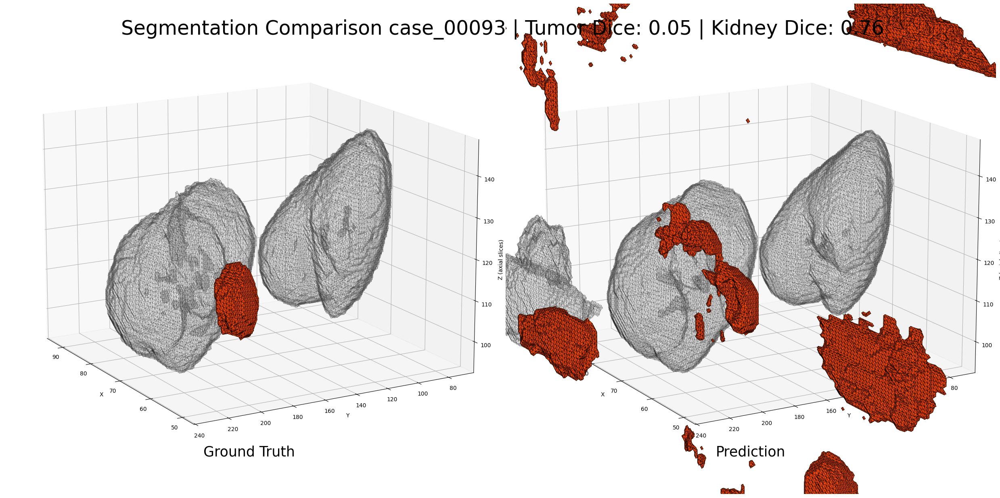

Plotting case_00172: GT shape (219, 179, 161), Pred shape (219, 179, 161)


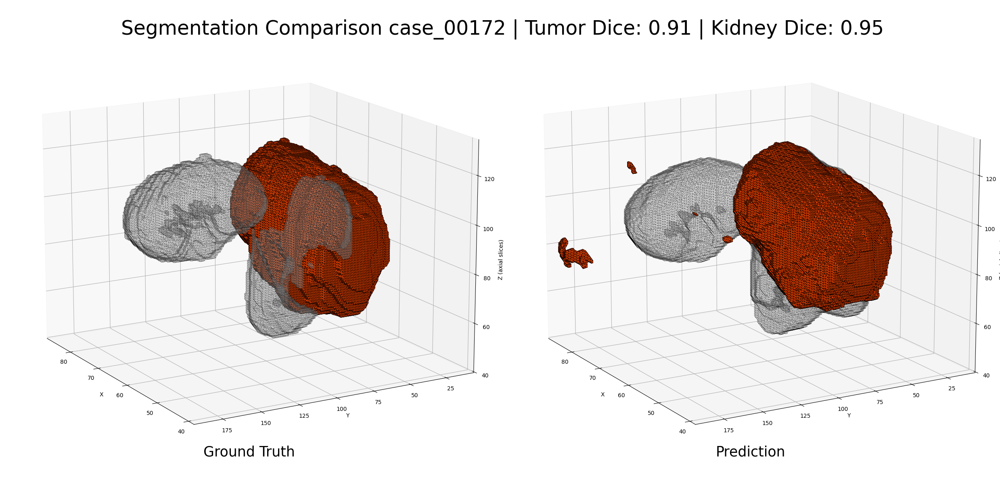

Plotting case_00192: GT shape (255, 212, 226), Pred shape (255, 212, 226)


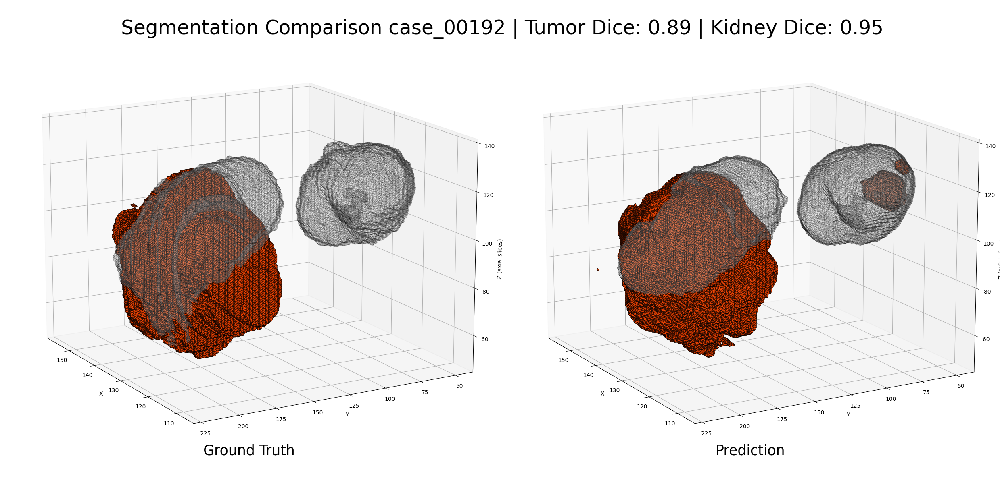

Plotting case_00125: GT shape (284, 228, 179), Pred shape (284, 228, 179)


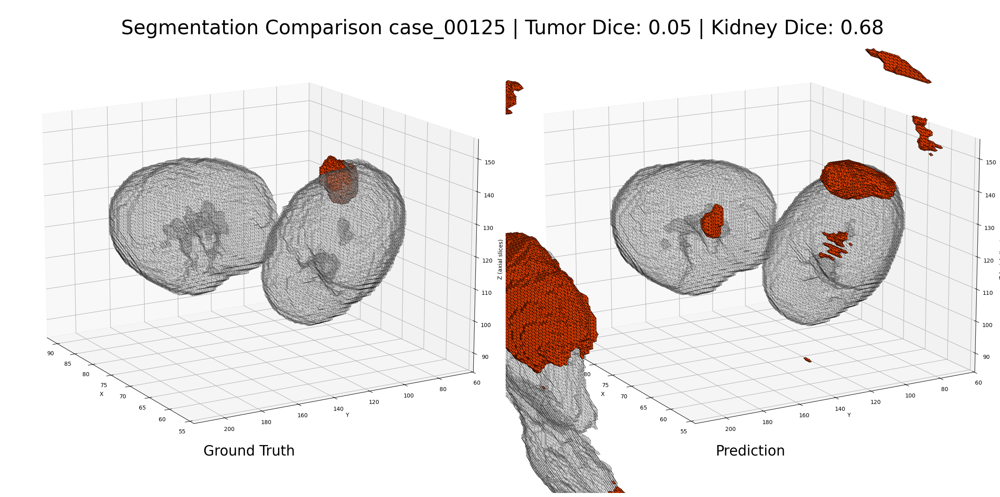

Plotting case_00126: GT shape (297, 262, 186), Pred shape (297, 262, 186)


In [ ]:
# Select Cases: good kidney dice, bad kidney dice, good tumor dice, bad tumor dice
# Sort Cases by kidney dice
sorted_cases_kidney = sorted(val_with_scores.items(), key=lambda x: x[1]["kidney_dice"], reverse=True)
sorted_cases_tumor = sorted(val_with_scores.items(), key=lambda x: x[1]["tumor_dice"], reverse=True)

# Select best and worst cases
best_kidney_cases = [case_id for case_id, data in sorted_cases_kidney[:5]]  # Top 5 kidney cases
worst_kidney_cases = [case_id for case_id, data in sorted_cases_kidney[-5:]]  # Bottom 5 kidney cases
best_tumor_cases = [case_id for case_id, data in sorted_cases_tumor[:5]]  # Top 5 tumor cases
worst_tumor_cases = [case_id for case_id, data in sorted_cases_tumor[-5:]]  # Bottom 5 tumor cases

# Combine all selected case IDs into a single set (removes duplicates)
selected_case_ids = set(best_kidney_cases + worst_kidney_cases + best_tumor_cases + worst_tumor_cases)
selected_val_data = {case_id: val_with_scores[case_id] for case_id in selected_case_ids}

plot_predictions_3D(selected_val_data, output_path=os.path.join(MODEL_PATH, "results", "comparison"), model_type="3d")

Define utility functions for GIF visualization with sagittal plane

In [ ]:
def get_viz_transforms():
    """
    Create transforms for visualization that preserve the full kidney region.
    Unlike training transforms, these don't crop to fixed size (80x160x160).
    """
    viz_transforms = Compose([
        LoadImaged(keys=["image", "label"]),
        EnsureChannelFirstd(keys=["image", "label"]),
        
        # Resample to consistent voxel spacing as per KiTS19 paper
        Spacingd(
            keys=["image", "label"],
            pixdim=(3.22, 1.62, 1.62),
            mode=("bilinear", "nearest")
        ),
        
        # Standardize orientation to RAS (Right-Anterior-Superior)
        Orientationd(keys=["image", "label"], axcodes="RAS"),
        
        # Apply intensity normalization based on KiTS19 paper values
        ScaleIntensityRanged(
            keys=["image"],
            a_min=-79, 
            a_max=304,
            b_min=-2.341,
            b_max=2.640,
            clip=True
        ),
        
        # Crop to kidney region with margin, preserving full anatomy
        CropForegroundd(
            keys=["image", "label"],
            source_key="image",
            margin=10
        ),
        
        EnsureTyped(keys=["image", "label"], dtype=torch.float32),
        ToTensord(keys=["image", "label"])
    ])
    return viz_transforms


def get_case_full_kidney(case, data_dir):
    """
    Load and preprocess a single case, preserving full kidney region.
    
    Args:
        case: Case identifier (e.g., "case_00123")
        data_dir: Root directory containing case folders
        
    Returns:
        tuple: (full_kidney_image, full_kidney_label) as tensors
    """
    viz_transforms = get_viz_transforms()
    
    imaging_path = os.path.join(data_dir, case, "imaging.nii.gz")
    segmentation_path = os.path.join(data_dir, case, "segmentation.nii.gz")
    
    data_list = [{
        "image": imaging_path, 
        "label": segmentation_path, 
        "case_id": case
    }]
    
    val_ds = Dataset(data=data_list, transform=viz_transforms)
    transformed_data = val_ds[0]
    
    full_kidney_image = transformed_data["image"] 
    full_kidney_label = transformed_data["label"]
    
    print(f"Full kidney region shape: {full_kidney_image.shape}")
    
    return full_kidney_image, full_kidney_label


def get_full_kidney_predictions(model, full_kidney_image, device):
    """
    Generate predictions for full kidney region using sliding window inference.
    
    Args:
        model: Trained model
        full_kidney_image: Input image tensor
        device: CUDA/CPU device
        
    Returns:
        torch.Tensor: Prediction mask with shape [D, H, W]
    """
    model.eval()
    with torch.no_grad():
        inputs = full_kidney_image.unsqueeze(0).to(device)  # Add batch dimension
        
        # Apply sliding window inference with same ROI size as training
        outputs = sliding_window_inference(
            inputs=inputs,
            roi_size=(80, 160, 160),
            sw_batch_size=1,
            overlap=0.25,
            predictor=model
        )
        
        # Convert logits to class predictions
        outputs_soft = torch.softmax(outputs, dim=1)
        predictions = torch.argmax(outputs_soft, dim=1, keepdim=True)
        
        # Remove batch and channel dimensions: [1, 1, D, H, W] -> [D, H, W]
        predictions = predictions.cpu().squeeze(0).squeeze(0)
        
        return predictions


def plot_single_slice_for_gif(case_id, img_slice, gt_slice, pred_slice, slice_idx):
    """
    Create a single slice comparison plot for GIF frame.
    
    Args:
        case_id: Case identifier for title
        img_slice: Grayscale CT slice
        gt_slice: Ground truth segmentation
        pred_slice: Model prediction
        slice_idx: Slice index for title
        
    Returns:
        PIL.Image: Plot as PIL Image for GIF creation
    """
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    
    # Color mapping: background=transparent, kidney=red, tumor=blue
    colors = ['none', 'red', 'blue']
    cmap = ListedColormap(colors)
    
    # Ground truth visualization
    axes[0].imshow(img_slice, cmap='gray', alpha=0.7)
    gt_masked = np.ma.masked_where(gt_slice == 0, gt_slice)
    axes[0].imshow(gt_masked, cmap=cmap, alpha=0.8, vmin=0, vmax=2)
    axes[0].set_title('Ground Truth', fontsize=12, fontweight='bold')
    axes[0].axis('off')
    
    # Prediction visualization
    axes[1].imshow(img_slice, cmap='gray', alpha=0.7)
    pred_masked = np.ma.masked_where(pred_slice == 0, pred_slice)
    axes[1].imshow(pred_masked, cmap=cmap, alpha=0.8, vmin=0, vmax=2)
    axes[1].set_title('Prediction', fontsize=12, fontweight='bold')
    axes[1].axis('off')
    
    # Calculate and display DICE scores
    kidney_dice = calculate_slice_dice(gt_slice, pred_slice, class_label=1)
    tumor_dice = calculate_slice_dice(gt_slice, pred_slice, class_label=2)
    
    dice_text = f'Kidney DICE: {kidney_dice:.3f}    Tumor DICE: {tumor_dice:.3f}'
    fig.text(0.5, 0.15, dice_text, ha='center', fontsize=14, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.3", facecolor="lightgray", alpha=0.8))
    
    # Add legend
    legend_elements = [
        patches.Patch(color='red', label='Kidney'),
        patches.Patch(color='blue', label='Tumor')
    ]
    fig.legend(handles=legend_elements, loc='upper right', bbox_to_anchor=(0.98, 0.98))
    
    plt.suptitle(f'{case_id} - Sagittal Slice {slice_idx}', fontsize=16, fontweight='bold')
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.25)
    
    # Convert matplotlib figure to PIL Image
    buf = io.BytesIO()
    plt.savefig(buf, format='png', dpi=100, bbox_inches='tight')
    buf.seek(0)
    img = Image.open(buf)
    img_copy = img.copy()  # Create copy before closing buffer
    buf.close()
    plt.close(fig)  # Free memory
    
    return img_copy


def calculate_slice_dice(gt_slice, pred_slice, class_label):
    """
    Calculate DICE coefficient for a specific class in a single 2D slice.
    
    Args:
        gt_slice: Ground truth slice
        pred_slice: Prediction slice  
        class_label: Class to evaluate (1=kidney, 2=tumor)
        
    Returns:
        float: DICE score [0, 1]
    """
    gt_binary = (gt_slice == class_label).astype(np.float32)
    pred_binary = (pred_slice == class_label).astype(np.float32)
    
    intersection = np.sum(gt_binary * pred_binary)
    union = np.sum(gt_binary) + np.sum(pred_binary)
    
    # Handle edge case: both masks empty
    if union == 0:
        return 1.0 if intersection == 0 else 0.0
    
    dice = (2.0 * intersection) / union
    return dice


def create_sagittal_gif(case_id, full_image, full_gt, full_pred, output_path, duration=500):
    """
    Create animated GIF showing sagittal slices with ground truth vs predictions.
    
    Args:
        case_id: Case identifier
        full_image, full_gt, full_pred: 3D arrays [D, H, W]
        output_path: Output GIF file path
        duration: Frame duration in milliseconds
    """
    # Convert tensors to numpy arrays
    img_np = full_image.cpu().numpy() if torch.is_tensor(full_image) else full_image
    gt_np = full_gt.cpu().numpy() if torch.is_tensor(full_gt) else full_gt
    pred_np = full_pred.cpu().numpy() if torch.is_tensor(full_pred) else full_pred
    
    # Remove channel dimension if present
    if len(img_np.shape) == 4:
        img_np = img_np.squeeze(0)
    if len(gt_np.shape) == 4:
        gt_np = gt_np.squeeze(0)
    
    print(f"Creating GIF for {case_id}...")
    print(f"Volume shape (D,H,W): {img_np.shape}")
    
    # Find slices containing kidney or tumor anatomy
    width = img_np.shape[2]  # Sagittal dimension
    anatomy_slices = []
    
    for slice_idx in range(width):
        gt_slice = gt_np[:, :, slice_idx]
        pred_slice = pred_np[:, :, slice_idx]
        
        # Include slice if it has anatomy in GT or predictions
        has_anatomy = np.any(gt_slice > 0) or np.any(pred_slice > 0)
        if has_anatomy:
            anatomy_slices.append(slice_idx)
    
    print(f"Total slices: {width}, Slices with anatomy: {len(anatomy_slices)}")
    if not anatomy_slices:
        print("No slices with anatomy found!")
        return
    
    print(f"Processing slices: {anatomy_slices[0]} to {anatomy_slices[-1]}")
    
    # Generate frames
    frames = []
    print("Generating frames...")
    
    for i, slice_idx in enumerate(anatomy_slices):
        print(f"Processing slice {slice_idx} ({i+1}/{len(anatomy_slices)})")
        
        # Extract sagittal slice and rotate for proper orientation
        img_slice = np.rot90(img_np[:, :, slice_idx], k=1)
        gt_slice = np.rot90(gt_np[:, :, slice_idx], k=1) 
        pred_slice = np.rot90(pred_np[:, :, slice_idx], k=1)
        
        frame = plot_single_slice_for_gif(case_id, img_slice, gt_slice, pred_slice, slice_idx)
        frames.append(frame)
    
    # Save as animated GIF
    print(f"Creating GIF with {len(frames)} frames...")
    frames[0].save(
        output_path,
        save_all=True,
        append_images=frames[1:],
        duration=duration,
        loop=0  # Infinite loop
    )
    
    print(f"GIF saved: {output_path}")
    print(f"Duration per frame: {duration}ms")
    
    # Clean up memory
    for frame in frames:
        frame.close()


def display_gif_in_jupyter(gif_path, width=800, height=400):
    """
    Display an animated GIF directly in Jupyter notebook.
    
    Args:
        gif_path: Path to the GIF file
        width: Display width in pixels
        height: Display height in pixels
        
    Returns:
        IPython.display.Image: Displayable GIF object
    """
    try:
        from IPython.display import Image as IPythonImage, display
        
        # Check if file exists
        if not os.path.exists(gif_path):
            print(f"GIF file not found: {gif_path}")
            return None
            
        # Display GIF with specified dimensions
        gif_display = IPythonImage(
            filename=gif_path,
            width=width,
            height=height
        )

        display(gif_display)
        
        print(f"Displaying GIF: {os.path.basename(gif_path)}")
        return gif_display
        
    except ImportError:
        print("IPython not available. Cannot display GIF in notebook.")
        print(f"GIF saved at: {gif_path}")
        return None


def visualize_case_as_gif(case_id, data_root, model, device, output_dir="./gifs", 
                         duration=500, display_in_notebook=True, display_width=800, display_height=400):
    """
    Complete pipeline to create GIF visualization for a single case.
    
    Args:
        case_id: Case identifier (e.g., "case_00123")
        data_root: Root data directory
        model: Trained segmentation model
        device: Computation device
        output_dir: Output directory for GIFs
        duration: Frame duration in milliseconds
        display_in_notebook: Whether to display GIF in Jupyter notebook
        display_width: Display width in pixels
        display_height: Display height in pixels
        
    Returns:
        str: Path to created GIF file
    """
    print(f"Creating GIF visualization for {case_id}...")
    
    os.makedirs(output_dir, exist_ok=True)
    
    # Load case data and generate predictions
    full_image, full_gt = get_case_full_kidney(case_id, data_root)
    full_pred = get_full_kidney_predictions(model, full_image, device)
    
    # Create GIF
    output_path = os.path.join(output_dir, f"{case_id}_sagittal_slices.gif")
    create_sagittal_gif(case_id, full_image, full_gt, full_pred, output_path, duration)
    
    print(f"Completed GIF for {case_id}")
    
    # Display in notebook if requested
    if display_in_notebook:
        display_gif_in_jupyter(output_path, display_width, display_height)
    
    return output_path


def create_multiple_case_gifs(case_list, data_root, model, device, output_dir="./gifs", 
                             duration=500, display_in_notebook=True, display_width=800, display_height=400):
    """
    Create GIF visualizations for multiple cases with error handling.
    
    Args:
        case_list: List of case identifiers
        data_root: Root data directory
        model: Trained segmentation model
        device: Computation device
        output_dir: Output directory for GIFs
        duration: Frame duration in milliseconds
        display_in_notebook: Whether to display GIFs in Jupyter notebook
        display_width: Display width in pixels
        display_height: Display height in pixels
        
    Returns:
        list: Paths to successfully created GIF files
    """
    created_gifs = []
    
    for case_id in case_list:
        print(f"\n{'='*50}")
        print(f"PROCESSING: {case_id}")
        print(f"{'='*50}")
        
        try:
            gif_path = visualize_case_as_gif(
                case_id, data_root, model, device, output_dir, duration, 
                display_in_notebook, display_width, display_height
            )
            created_gifs.append(gif_path)
        except Exception as e:
            print(f"Error creating GIF for {case_id}: {e}")
    
    print(f"\nSuccessfully created {len(created_gifs)} GIFs:")
    for gif_path in created_gifs:
        print(f"  - {gif_path}")
    
    return created_gifs


def display_existing_gif(gif_path, width=800, height=400):
    """
    Display an existing GIF file in Jupyter notebook.
    
    Args:
        gif_path: Path to existing GIF file
        width: Display width in pixels
        height: Display height in pixels
    """
    return display_gif_in_jupyter(gif_path, width, height)

Now, create GIF visualization

In [ ]:
# Create and display single case GIF
case_id = "case_00199"
gif_path = visualize_case_as_gif(
    case_id, 
    DATA_ROOT, 
    model, 
    device, 
    display_in_notebook=True,
    display_width=1000,  # Larger display
    display_height=500
)

In [ ]:
#display_existing_gif("./gifs/case_00199_sagittal_slices.gif", width=1000, height=500)